In [1]:
# !pip install category-encoders

In [2]:
import numpy as np
import pandas as pd
from category_encoders import OneHotEncoder

Carregando o dataset

In [3]:
link = 'C:/Users/Kanel/vEnv/trabalho-final/database/Financial-Data.csv'

dfMerge = pd.read_csv(link)
dfMerge

,Entry_id,age,pay_schedule,home_owner,income,months_employed,years_employed,current_address_year,personal_account_m,personal_account_y,...,amount_requested,risk_score,risk_score_2,risk_score_3,risk_score_4,risk_score_5,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
0,7629673,40,bi-weekly,1,3135,0,3,3,6,2,...,550,36200,0.737398,0.903517,0.487712,0.515977,0.580918,0.380918,10,1
1,3560428,61,weekly,0,3180,0,6,3,2,7,...,600,30150,0.738510,0.881027,0.713423,0.826402,0.730720,0.630720,9,0
2,6934997,23,weekly,0,1540,6,0,0,7,1,...,450,34550,0.642993,0.766554,0.595018,0.762284,0.531712,0.531712,7,0
3,5682812,40,bi-weekly,0,5230,0,6,1,2,7,...,700,42150,0.665224,0.960832,0.767828,0.778831,0.792552,0.592552,8,1
4,5335819,33,semi-monthly,0,3590,0,5,2,2,8,...,1100,53850,0.617361,0.857560,0.613487,0.665523,0.744634,0.744634,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,9949728,31,monthly,0,3245,0,5,3,2,6,...,700,71700,0.691126,0.928196,0.664112,0.838012,0.727705,0.627705,2,0
17904,9442442,46,bi-weekly,0,6525,0,2,1,3,3,...,800,51800,0.648525,0.970832,0.699241,0.844724,0.774918,0.474918,3,0
17905,9857590,46,weekly,0,2685,0,5,1,1,8,...,1200,59650,0.677975,0.918141,0.687981,0.939101,0.472045,0.672045,9,0
17906,8708471,42,bi-weekly,0,2515,0,3,5,6,1,...,400,80200,0.642741,0.885684,0.456448,0.686823,0.406568,0.406568,3,1


Eliminação de colunas com valores de correlação muito próximos a zero.

Será buscado o valor absoluto das correlações usando o 'e-signed' como referência.

In [4]:
dfMergeModule = abs(dfMerge.corr()[['e_signed']])

dfMergeModuleSorted = dfMergeModule.sort_values(['e_signed'])['e_signed']
dfMergeModuleSorted < 0.01

Entry_id                 True
years_employed           True
risk_score_4             True
risk_score_5             True
months_employed         False
risk_score_2            False
current_address_year    False
personal_account_y      False
ext_quality_score_2     False
inquiries_last_month    False
income                  False
ext_quality_score       False
risk_score_3            False
has_debt                False
home_owner              False
amount_requested        False
personal_account_m      False
risk_score              False
age                     False
e_signed                False
Name: e_signed, dtype: bool

As colunas que retornaram 'True' serão dropadas.

In [5]:
dfMerge = dfMerge.drop([
    'risk_score_5', 'Entry_id', 
    'years_employed', 'risk_score_4'
], axis=1)

dfMerge

,age,pay_schedule,home_owner,income,months_employed,current_address_year,personal_account_m,personal_account_y,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
0,40,bi-weekly,1,3135,0,3,6,2,1,550,36200,0.737398,0.903517,0.580918,0.380918,10,1
1,61,weekly,0,3180,0,3,2,7,1,600,30150,0.738510,0.881027,0.730720,0.630720,9,0
2,23,weekly,0,1540,6,0,7,1,1,450,34550,0.642993,0.766554,0.531712,0.531712,7,0
3,40,bi-weekly,0,5230,0,1,2,7,1,700,42150,0.665224,0.960832,0.792552,0.592552,8,1
4,33,semi-monthly,0,3590,0,2,2,8,1,1100,53850,0.617361,0.857560,0.744634,0.744634,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,31,monthly,0,3245,0,3,2,6,1,700,71700,0.691126,0.928196,0.727705,0.627705,2,0
17904,46,bi-weekly,0,6525,0,1,3,3,1,800,51800,0.648525,0.970832,0.774918,0.474918,3,0
17905,46,weekly,0,2685,0,1,1,8,1,1200,59650,0.677975,0.918141,0.472045,0.672045,9,0
17906,42,bi-weekly,0,2515,0,5,6,1,1,400,80200,0.642741,0.885684,0.406568,0.406568,3,1


Como aa coluna 'pay_schedule' apresenta valores em string:

 [ 'bi-weekly' | 'weekly' | 'semi-monthly' | 'monthly' ]


 Será feito o uso da codificação OneHot(fictícia) para recursos categóricos produz um recurso por categoria, cada binário. (Fonte: https://contrib.scikit-learn.org/category_encoders/onehot.html).


---

Dessa forma, teremos 4 colunas binárias de 'pay_schedule'

In [6]:
one = OneHotEncoder(cols=['pay_schedule']).fit_transform(dfMerge['pay_schedule'])

dfMerge = pd.concat([one, dfMerge.drop(['pay_schedule'], axis=1)], axis=1)
dfMerge

,pay_schedule_1,pay_schedule_2,pay_schedule_3,pay_schedule_4,age,home_owner,income,months_employed,current_address_year,personal_account_m,personal_account_y,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed
0,1,0,0,0,40,1,3135,0,3,6,2,1,550,36200,0.737398,0.903517,0.580918,0.380918,10,1
1,0,1,0,0,61,0,3180,0,3,2,7,1,600,30150,0.738510,0.881027,0.730720,0.630720,9,0
2,0,1,0,0,23,0,1540,6,0,7,1,1,450,34550,0.642993,0.766554,0.531712,0.531712,7,0
3,1,0,0,0,40,0,5230,0,1,2,7,1,700,42150,0.665224,0.960832,0.792552,0.592552,8,1
4,0,0,1,0,33,0,3590,0,2,2,8,1,1100,53850,0.617361,0.857560,0.744634,0.744634,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,0,0,0,1,31,0,3245,0,3,2,6,1,700,71700,0.691126,0.928196,0.727705,0.627705,2,0
17904,1,0,0,0,46,0,6525,0,1,3,3,1,800,51800,0.648525,0.970832,0.774918,0.474918,3,0
17905,0,1,0,0,46,0,2685,0,1,1,8,1,1200,59650,0.677975,0.918141,0.472045,0.672045,9,0
17906,1,0,0,0,42,0,2515,0,5,6,1,1,400,80200,0.642741,0.885684,0.406568,0.406568,3,1


Em relação as colunas do tipo 'personal_account' existem 2 versões: mês e ano. Portanto, é possível juntar ambas colunas em uma só ao multiplicar a do ano por 12 e somar com a do mês.

Depois de criada a nova coluna com o resultado dessa operação, só falta apagar as colunas antigas.

In [7]:
dfMerge["personal_accounts_month"] = dfMerge["personal_account_y"] * 12 + dfMerge["personal_account_m"]

dfMerge = dfMerge.drop(["personal_account_y", "personal_account_m"], axis=1)

dfMerge

,pay_schedule_1,pay_schedule_2,pay_schedule_3,pay_schedule_4,age,home_owner,income,months_employed,current_address_year,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed,personal_accounts_month
0,1,0,0,0,40,1,3135,0,3,1,550,36200,0.737398,0.903517,0.580918,0.380918,10,1,30
1,0,1,0,0,61,0,3180,0,3,1,600,30150,0.738510,0.881027,0.730720,0.630720,9,0,86
2,0,1,0,0,23,0,1540,6,0,1,450,34550,0.642993,0.766554,0.531712,0.531712,7,0,19
3,1,0,0,0,40,0,5230,0,1,1,700,42150,0.665224,0.960832,0.792552,0.592552,8,1,86
4,0,0,1,0,33,0,3590,0,2,1,1100,53850,0.617361,0.857560,0.744634,0.744634,12,0,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,0,0,0,1,31,0,3245,0,3,1,700,71700,0.691126,0.928196,0.727705,0.627705,2,0,74
17904,1,0,0,0,46,0,6525,0,1,1,800,51800,0.648525,0.970832,0.774918,0.474918,3,0,39
17905,0,1,0,0,46,0,2685,0,1,1,1200,59650,0.677975,0.918141,0.472045,0.672045,9,0,97
17906,1,0,0,0,42,0,2515,0,5,1,400,80200,0.642741,0.885684,0.406568,0.406568,3,1,18


A fim de reduzir a variação do 'risk_score' foi realizado uma operação buscando o logaritmo de base 2 dos valores dessa coluna e transformando no valor aproximado com 4 casas decimais.

In [8]:
dfMerge['risk_score'] = round(np.log2(dfMerge['risk_score']), 4)
dfMerge

,pay_schedule_1,pay_schedule_2,pay_schedule_3,pay_schedule_4,age,home_owner,income,months_employed,current_address_year,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed,personal_accounts_month
0,1,0,0,0,40,1,3135,0,3,1,550,15.1437,0.737398,0.903517,0.580918,0.380918,10,1,30
1,0,1,0,0,61,0,3180,0,3,1,600,14.8799,0.738510,0.881027,0.730720,0.630720,9,0,86
2,0,1,0,0,23,0,1540,6,0,1,450,15.0764,0.642993,0.766554,0.531712,0.531712,7,0,19
3,1,0,0,0,40,0,5230,0,1,1,700,15.3632,0.665224,0.960832,0.792552,0.592552,8,1,86
4,0,0,1,0,33,0,3590,0,2,1,1100,15.7167,0.617361,0.857560,0.744634,0.744634,12,0,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,0,0,0,1,31,0,3245,0,3,1,700,16.1297,0.691126,0.928196,0.727705,0.627705,2,0,74
17904,1,0,0,0,46,0,6525,0,1,1,800,15.6607,0.648525,0.970832,0.774918,0.474918,3,0,39
17905,0,1,0,0,46,0,2685,0,1,1,1200,15.8642,0.677975,0.918141,0.472045,0.672045,9,0,97
17906,1,0,0,0,42,0,2515,0,5,1,400,16.2913,0.642741,0.885684,0.406568,0.406568,3,1,18


Adaptando algumas colunas para reduzir proporcionalmente seus valores:

income / 100

amount_request / 10

In [9]:
dfMerge['income'] = dfMerge['income'] / 100
dfMerge['amount_requested'] = dfMerge['amount_requested'] / 10

Após a análise, verificou-se que os meses empregado e a idade não teriam tanta relevância, portanto foram dropados.

In [10]:
dfMerge = dfMerge.drop(['months_employed', 'age'], axis=1)
dfMerge

,pay_schedule_1,pay_schedule_2,pay_schedule_3,pay_schedule_4,home_owner,income,current_address_year,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed,personal_accounts_month
0,1,0,0,0,1,31.35,3,1,55.0,15.1437,0.737398,0.903517,0.580918,0.380918,10,1,30
1,0,1,0,0,0,31.80,3,1,60.0,14.8799,0.738510,0.881027,0.730720,0.630720,9,0,86
2,0,1,0,0,0,15.40,0,1,45.0,15.0764,0.642993,0.766554,0.531712,0.531712,7,0,19
3,1,0,0,0,0,52.30,1,1,70.0,15.3632,0.665224,0.960832,0.792552,0.592552,8,1,86
4,0,0,1,0,0,35.90,2,1,110.0,15.7167,0.617361,0.857560,0.744634,0.744634,12,0,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,0,0,0,1,0,32.45,3,1,70.0,16.1297,0.691126,0.928196,0.727705,0.627705,2,0,74
17904,1,0,0,0,0,65.25,1,1,80.0,15.6607,0.648525,0.970832,0.774918,0.474918,3,0,39
17905,0,1,0,0,0,26.85,1,1,120.0,15.8642,0.677975,0.918141,0.472045,0.672045,9,0,97
17906,1,0,0,0,0,25.15,5,1,40.0,16.2913,0.642741,0.885684,0.406568,0.406568,3,1,18


Para aproximar-se aos valores do 'risk_score' foram feitas adaptações nas colunas:

'risk_score_2' | 'risk_score_3' | 'ext_quality_score' | 'ext_quality_score_2'

In [11]:
dfMerge['risk_score_2'] = dfMerge['risk_score_2'] * 10
dfMerge['risk_score_3'] = dfMerge['risk_score_3'] * 10

dfMerge['ext_quality_score'] = dfMerge['ext_quality_score'] * 10
dfMerge['ext_quality_score_2'] = dfMerge['ext_quality_score_2'] * 10

dfMerge

,pay_schedule_1,pay_schedule_2,pay_schedule_3,pay_schedule_4,home_owner,income,current_address_year,has_debt,amount_requested,risk_score,risk_score_2,risk_score_3,ext_quality_score,ext_quality_score_2,inquiries_last_month,e_signed,personal_accounts_month
0,1,0,0,0,1,31.35,3,1,55.0,15.1437,7.373983,9.035172,5.80918,3.80918,10,1,30
1,0,1,0,0,0,31.80,3,1,60.0,14.8799,7.385101,8.810267,7.30720,6.30720,9,0,86
2,0,1,0,0,0,15.40,0,1,45.0,15.0764,6.429933,7.665537,5.31712,5.31712,7,0,19
3,1,0,0,0,0,52.30,1,1,70.0,15.3632,6.652235,9.608323,7.92552,5.92552,8,1,86
4,0,0,1,0,0,35.90,2,1,110.0,15.7167,6.173613,8.575597,7.44634,7.44634,12,0,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17903,0,0,0,1,0,32.45,3,1,70.0,16.1297,6.911261,9.281963,7.27705,6.27705,2,0,74
17904,1,0,0,0,0,65.25,1,1,80.0,15.6607,6.485252,9.708318,7.74918,4.74918,3,0,39
17905,0,1,0,0,0,26.85,1,1,120.0,15.8642,6.779748,9.181406,4.72045,6.72045,9,0,97
17906,1,0,0,0,0,25.15,5,1,40.0,16.2913,6.427412,8.856841,4.06568,4.06568,3,1,18


## Bem, vamos aplicar o PCA em cima do dataset tratado anteriormente:

Em primeiro lugar vamos separar nosso dfMerge em data e target:

In [12]:
data = dfMerge.drop("e_signed", axis=1)
target = dfMerge['e_signed']

Vamos analisar o PCA aplicado em sua totalidade:

In [13]:
from sklearn.decomposition import PCA
import plotly.express as px

pca = PCA()
components = pca.fit_transform(data)

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

In [14]:
fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(16),
    color=dfMerge["e_signed"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

Conforme observado, 2 dimensões já alcança uma boa representatividade (86.4 + 9.5 = 95.9%).

Portanto iremos usar essas 2 dimensões.

In [15]:
pca = PCA(n_components=2)
components = pca.fit_transform(data)

total_var = pca.explained_variance_ratio_.sum() * 100
print('Total da variância capturada: ', total_var)

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

Total da variância capturada:  95.88197676031537


In [23]:
components

array([[-40.57868967, -14.71051799],
       [-34.55961136,  41.18356823],
       [-51.78928056, -25.30387227],
       ...,
       [ 25.17406499,  51.22758568],
       [-56.14150049, -26.32504871],
       [-36.10889385, -28.59906415]])

### Visualizando nosso dataset via Plotly

In [16]:


fig = px.scatter_matrix(
    components,
    labels=labels,
    color=dfMerge["e_signed"]
)

fig.show()

## Trabalhando com a solução proposta:

In [17]:
import tensorflow as tf
from keras.layers import Dense, BatchNormalization, Dropout
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
import os, math
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, f1_score, classification_report, confusion_matrix

Separando o dataset em treino e teste

In [18]:
def create_data(dfMerge):
    X = np.array(components)
    y = np.asarray(dfMerge['e_signed']).astype('int64')
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)
    
    sc = MinMaxScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    train_ds = tf.data.Dataset.from_tensor_slices((X_train, y_train)).batch(32)
    test_ds = tf.data.Dataset.from_tensor_slices((X_test, y_test)).batch(32)
    
    return train_ds, test_ds


train_ds, test_ds = create_data(dfMerge)

Criação da função de ativação e classes para a elaboração da rede neural.

In [19]:
def GELU(x):
    res = 0.5 * x * (1 + tf.nn.tanh(math.sqrt(2 / math.pi) * (x + 0.044715 * (x ** 3))))
    return res


class ResMLPBlock(tf.keras.layers.Layer):
    def __init__(self, units, residual_path):
        super(ResMLPBlock, self).__init__()
        self.residual_path = residual_path
        self.D1 = Dense(units, activation='relu')
        self.D2 = Dense(units, activation='relu')

        if self.residual_path:
            self.D3 = Dense(units)
            self.D4 = Dense(units)

    def call(self, inputs):
        residual = inputs

        x = self.D1(inputs)
        y = self.D2(x)

        if self.residual_path:
            residual = self.D3(inputs)
            residual = GELU(residual)
            residual = self.D4(residual)
            residual = GELU(residual)

        output = y + residual
        return output


class ResMLP(tf.keras.Model):
    def __init__(self, initial_filters, block_list, num_classes):
        super(ResMLP, self).__init__()
        self.initial_filters = initial_filters
        self.block_list = block_list

        self.D1 = Dense(self.initial_filters, activation='relu')
        self.B1 = BatchNormalization()

        self.blocks = tf.keras.models.Sequential()
        for block_id in range(len(block_list)):
            for layer_id in range(block_list[block_id]):
                if block_id != 0 and layer_id == 0:
                    block = ResMLPBlock(units=self.initial_filters, residual_path=True)
                else:
                    block = ResMLPBlock(units=self.initial_filters, residual_path=False)
                self.blocks.add(block)
            self.initial_filters *= 2
        self.D2 = Dense(num_classes, activation='softmax')


    def call(self, inputs):
        x = self.D1(inputs)
        x = self.B1(x)
        x = self.blocks(x)
        y = self.D2(x)
        return y

Compilação e treinamento da rede neural.

Em comparação ao original, foi alterado o 'initial_filters' anteriormente 32 virou 40; o 'optimizer' anteriormente 'adam' e virou 'rmsprop'; o número de épocas (10 -> 20) e o 'batch_size' anteriormente 32 virou 40.

In [20]:
net = ResMLP(initial_filters=40, block_list=[2, 2, 2], num_classes=2)

net.compile(optimizer='rmsprop',
            loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
            metrics=['sparse_categorical_accuracy'])

history = net.fit(train_ds, epochs=20, batch_size=40, validation_data=test_ds)

net.summary()

Epoch 1/20
420/420 [==============================] - 4s 3ms/step - loss: 0.6815 - sparse_categorical_accuracy: 0.5414 - val_loss: 0.6922 - val_sparse_categorical_accuracy: 0.5128
Epoch 2/20
420/420 [==============================] - 1s 3ms/step - loss: 0.6740 - sparse_categorical_accuracy: 0.5486 - val_loss: 0.6753 - val_sparse_categorical_accuracy: 0.5490
Epoch 3/20
420/420 [==============================] - 1s 3ms/step - loss: 0.6726 - sparse_categorical_accuracy: 0.5487 - val_loss: 0.6758 - val_sparse_categorical_accuracy: 0.5530
Epoch 4/20
420/420 [==============================] - 1s 3ms/step - loss: 0.6713 - sparse_categorical_accuracy: 0.5520 - val_loss: 0.6717 - val_sparse_categorical_accuracy: 0.5602
Epoch 5/20
420/420 [==============================] - 1s 3ms/step - loss: 0.6705 - sparse_categorical_accuracy: 0.5559 - val_loss: 0.6710 - val_sparse_categorical_accuracy: 0.5611
Epoch 6/20
420/420 [==============================] - 1s 3ms/step - loss: 0.6695 - sparse_categorica

Verificação da perda e acurácia no treino e validação.

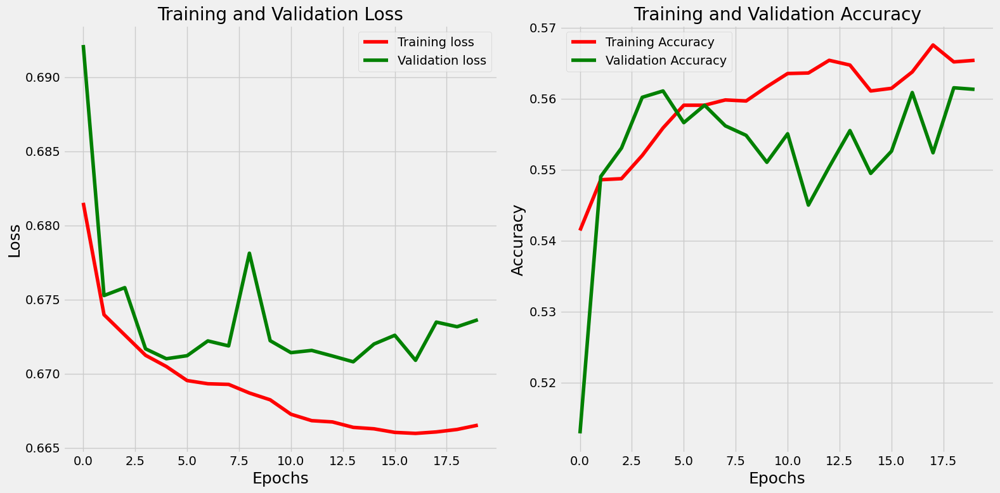

In [21]:
def plot_auc_acc_loss(history, epochs):
    tacc = history.history['sparse_categorical_accuracy']
    tloss = history.history['loss']

    vacc = history.history['val_sparse_categorical_accuracy']
    vloss = history.history['val_loss']

    Epochs = [i for i in range(epochs)]

    plt.style.use('fivethirtyeight')
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 8))
    axes[0].plot(Epochs, tloss, 'r', label='Training loss')
    axes[0].plot(Epochs, vloss, 'g', label='Validation loss')
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epochs', fontsize=18)
    axes[0].set_ylabel('Loss', fontsize=18)
    axes[0].legend()

    axes[1].plot(Epochs, tacc, 'r', label='Training Accuracy')
    axes[1].plot(Epochs, vacc, 'g', label='Validation Accuracy')
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epochs', fontsize=18)
    axes[1].set_ylabel('Accuracy', fontsize=18)
    axes[1].legend()

    plt.tight_layout()
    plt.show()

    return Epochs

Epochs = plot_auc_acc_loss(history, epochs=20)

Uso das métricas para avaliar o desempenho.

1/1 [==============================] - 0s 166ms/step
there were 1964 errors in 4477 tests for an accuracy of  56.13%


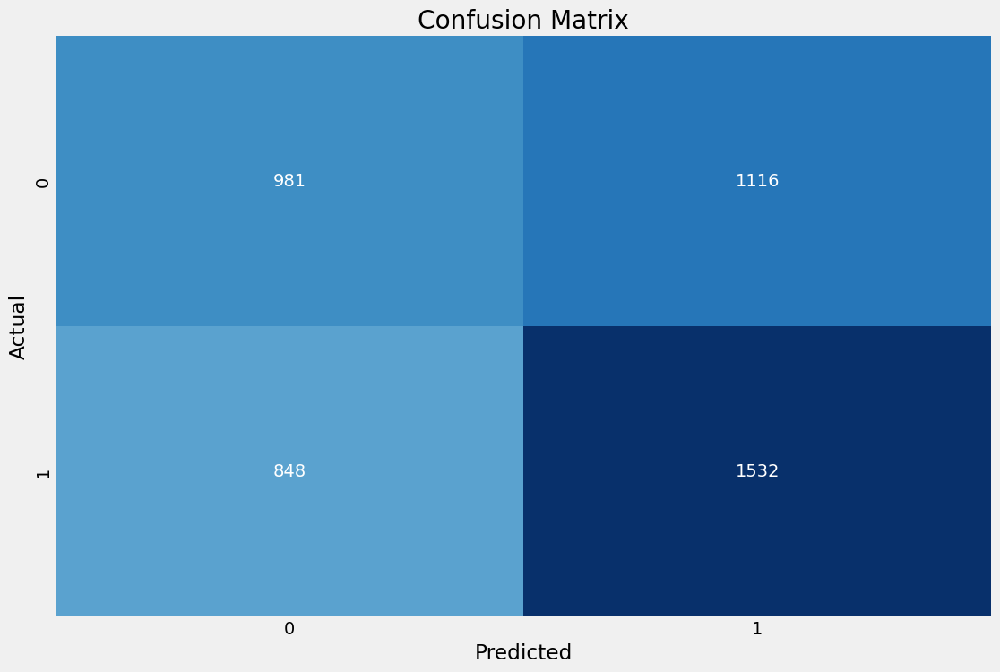

Classification Report:
----------------------
               precision    recall  f1-score   support

           0     0.5364    0.4678    0.4997      2097
           1     0.5785    0.6437    0.6094      2380

    accuracy                         0.5613      4477
   macro avg     0.5575    0.5558    0.5546      4477
weighted avg     0.5588    0.5613    0.5580      4477



In [22]:
def predictor(test_ds):
    y_pred = []
    y_true = []
    errors = 0
    for X_test, y_test in test_ds:
        pred = tf.argmax(net.predict(X_test), axis=1)
        for i in range(len(pred)):
            pred_index = pred[i]
            true_index = y_test[i]
            if pred_index != true_index:
                errors += 1
            y_pred.append(pred_index)
            y_true.append(true_index)
            
    acc = (1 - errors / len(y_true)) * 100
    msg = f'there were {errors} errors in {len(y_true)} tests for an accuracy of {acc:6.2f}%'
    print(msg)
    ypred = np.array(y_pred)
    ytrue = np.array(y_true)
    f1score = f1_score(ytrue, ypred, average='weighted') * 100

    if len(set(ytrue)) <= 30:
        cm = confusion_matrix(y_true, y_pred)

        plt.figure(figsize=(12, 8))
        sns.heatmap(cm, annot=True, vmin=0, fmt='g', cmap='Blues', cbar=False)
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.title("Confusion Matrix")
        plt.show()

    clr = classification_report(y_true, y_pred, digits=4)
    print("Classification Report:\n----------------------\n", clr)

    return errors, f1score

errors, f1score = predictor(test_ds)

Verificou-se que não houve grandes mudanças em relação ao original apesar da mudança no dataset (com o uso do PCA) e a mudança de alguns parametros.

Verificando pelo f1-score temos os seguintes resultados:

Original   - f1-score = 0.5676

Modificado - f1-score = 0.5754